# Connective fields analysis

This code illustrate connective field analysis as in Knapen 2022 PNAS.</br>
Inspired from https://github.com/VU-Cog-Sci/prfpy/blob/connective_fields/test/develop/CF_progress.ipynb

### Stage 1. define source region for CF models

In [1]:
# General imports
import cortex
import importlib
import ipdb
import json
import numpy as np
from scipy import stats
from scipy.stats import pearsonr, zscore
import nibabel as nb
import os
import sys
from copy import deepcopy
sys.path.append("{}/../../utils".format(os.getcwd()))
from pycortex_utils import draw_cortex, set_pycortex_config_file
deb = ipdb.set_trace

# Define analysis parameters
with open('../../settings.json') as f:
    json_s = f.read()
    analysis_info = json.loads(json_s)
xfm_name = analysis_info["xfm_name"]
high_pass_type = analysis_info['high_pass_type']

main_dir = '/Users/martinszinte/disks/meso_S/data'
project_dir = 'gaze_exp'
subject = 'sub-001'

# Set pycortex db and colormaps
cortex_dir = "{}/{}/derivatives/pp_data/cortex".format(main_dir, project_dir)
set_pycortex_config_file(cortex_dir)
importlib.reload(cortex)

<module 'cortex' from '/Users/martinszinte/anaconda3/envs/mszinte/lib/python3.9/site-packages/cortex/__init__.py'>

### Step 0. Define classes and functions

In [2]:
def vertex_plot(subject, data, vmin, vmax, rois=False, colorbar=False, cmap='plasma', ax=None):
    braindata = cortex.Vertex(data, subject=subject, vmin=vmin, vmax=vmax, cmap=cmap)
    fig = cortex.quickshow(braindata, with_curvature=True, with_rois=rois, with_colorbar=colorbar, fig=ax)

def vertex_alpha_plot(subject, data, alpha, vmin, vmax, vmin_alpha, vmax_alpha, rois=False, colorbar=False, cmap='plasma_alpha', ax=None):
    braindata = cortex.Vertex2D(data, alpha, subject=subject, vmin=vmin, vmax=vmax, vmin2=vmin_alpha, vmax2=vmax_alpha, cmap=cmap)
    fig = cortex.quickshow(braindata, with_curvature=True, with_rois=rois, with_colorbar=colorbar, fig=ax)

def stimulus_through_prf(prfs, stimulus, dx, mask=None):
    """stimulus_through_prf
    dot the stimulus and the prfs
    Parameters
    ----------
    prfs : numpy.ndarray
        the array of prfs. 
    stimulus : numpy.ndarray
        the stimulus design matrix, either convolved with hrf or not.
    mask : numpy.ndarray
        a mask in feature space, of dimensions equal to 
        the spatial dimensions of both stimulus and receptive field
    """
    assert prfs.shape[1:] == stimulus.shape[:-1], \
        """prf array dimensions {prfdim} and input stimulus array dimensions {stimdim} 
        must have same dimensions""".format(
            prfdim=prfs.shape[1:],
            stimdim=stimulus.shape[:-1])
    if mask == None:
        prf_r = prfs.reshape((prfs.shape[0], -1))
        stim_r = stimulus.reshape((-1, stimulus.shape[-1]))
    else:
        assert prfs.shape[1:] == mask.shape and mask.shape == stimulus.shape[:-1], \
            """mask dimensions {maskdim}, prf array dimensions {prfdim}, 
            and input stimulus array dimensions {stimdim} 
            must have same dimensions""".format(
                maskdim=mask.shape,
                prfdim=prfs.shape[1:],
                stimdim=stimulus.shape[:-1])
        prf_r = prfs[:, mask]
        stim_r = stimulus[mask, :]
    return prf_r @ stim_r * (dx ** len(stimulus.shape[:-1]))

In [3]:
class subsurface(object):
    
    """subsurface
        This is a utility that uses pycortex for making sub-surfaces for CF fitting.
        
    """

    def __init__(self,cx_sub,boolmasks,surftype='fiducial'):
        
        """__init__
        Parameters
        ----------
        cx_sub : The name of the cx subject (string). This is used to get surfaces from the pycx database.
        boolmasks: A list of boolean arrays that define the vertices that correspond to the ROI one wants to make a subsurface from [left hem, right hem].
        surftype: The surface (default = fiducial).
        """
        
        self.cx_sub=cx_sub
        self.surftype=surftype
        self.boolmasks=boolmasks
        self.mask=np.concatenate([self.boolmasks[0],self.boolmasks[1]]).astype(int) # Put the mask into int format for plotting.
        

        
    def create(self):
        """get_surfaces
        Function that creates the subsurfaces.
        """
        
        self.get_surfaces()
        self.generate()
        self.get_geometry()
        self.pad_distance_matrices()
        
    def get_surfaces(self):
        
        """get_surfaces
        Accesses the pycortex database to return the subject surfaces (left and right).
        
        Returns
        -------
        subsurface_L, subsurface_R: A pycortex subsurfaces classes for each hemisphere (These are later deleted by 'get_geometry', but can be re-created with a call to this function).
        self.subsurface_verts_L,self.subsurface_verts_R : The whole brain indices of each vertex in the subsurfaces.
        
        """
        
        self.surfaces = [cortex.polyutils.Surface(*d)
        for d in cortex.db.get_surf(self.cx_sub, self.surftype)]
                
    def generate(self):
        
        """generate
        Use the masks defined in boolmasks to define subsurfaces.
        """
        
        print('Generating subsurfaces')
        self.subsurface_L = self.surfaces[0].create_subsurface(vertex_mask=self.boolmasks[0]) # Create sub-surface, left hem.
        self.subsurface_R = self.surfaces[1].create_subsurface(vertex_mask=self.boolmasks[1]) # Create sub-surface, right hem.
        
        # Get the whole-brain indices for those vertices contained in the subsurface.
        self.subsurface_verts_L=np.where(self.subsurface_L.subsurface_vertex_map!=stats.mode(self.subsurface_L.subsurface_vertex_map)[0][0])[0]
        self.subsurface_verts_R=np.where(self.subsurface_R.subsurface_vertex_map!=stats.mode(self.subsurface_R.subsurface_vertex_map)[0][0])[0]+self.subsurface_L.subsurface_vertex_map.shape[-1]
        

    def get_geometry(self):
        
        """get_geometry
        Calculates geometric info about the sub-surfaces. Computes geodesic distances from each point of the sub-surface.
        
        Returns
        -------
        dists_L, dists_R: Matrices of size n vertices x n vertices that describes the distances between all vertices in each hemisphere of the subsurface.
        subsurface_verts: The whole brain indices of each vertex in the subsurface.
        leftlim: The index that indicates the boundary between the left and right hemisphere. 
        """
        
        # Assign some variables to determine where the boundary between the hemispheres is. 
        self.leftlim=np.max(self.subsurface_verts_L)        
        self.subsurface_verts=np.concatenate([self.subsurface_verts_L,self.subsurface_verts_R])
        
        # Make the distance x distance matrix.
        ldists,rdists=[],[]

        print('Creating distance by distance matrices')
        
        for i in range(len(self.subsurface_verts_L)):
            ldists.append(self.subsurface_L.geodesic_distance([i]))
        self.dists_L=np.array(ldists)
        
        for i in range(len(self.subsurface_verts_R)):
            rdists.append(self.subsurface_R.geodesic_distance([i]))
        self.dists_R=np.array(rdists)
        
        self.surfaces,self.subsurface_L,self.subsurface_R=None,None,None # Get rid of these as they are harmful for pickling. We no longer need them.
        
        
    def pad_distance_matrices(self,padval=np.Inf):
        
        """pad_distance_matrices
        Pads the distance matrices so that distances to the opposite hemisphere are np.inf
        Stack them on top of each other so they will have the same size as the design matrix
       
        
        Returns
        -------
        distance_matrix: A matrix of size n vertices x n vertices that describes the distances between all vertices in the subsurface.
        """
        
        padL=np.pad(self.dists_L, ((0, 0), (0, self.dists_R.shape[-1])),constant_values=np.Inf) # Pad the right hem with np.inf.
        padR=np.pad(self.dists_R, ((0, 0), (self.dists_L.shape[-1],0)),constant_values=np.Inf) # pad the left hem with np.inf..
        
        self.distance_matrix=np.vstack([padL,padR]) # Now stack.
        
    def elaborate(self):
        
        """elaborate
        Prints information about the created subsurfaces.
        """
            
        print(f"Maximum distance across left subsurface: {np.max(self.dists_L)} mm")
        rint(f"Maximum distance across right subsurface: {np.max(self.dists_R)} mm")
        print(f"Vertices in left hemisphere: {self.dists_L.shape[-1]}")
        print(f"Vertices in right hemisphere: {self.dists_R.shape[-1]}")

class CFStimulus(object):
    
    """CFStimulus
    Minimal CF stimulus class. Creates a design matrix for CF models by taking the data within a sub-surface (e.g. V1).
    """
    
    def __init__(self,
                 data,
                 vertinds,
                 distances,**kwargs):
        
        """__init__
        Parameters
        ----------
        data : numpy.ndarray
            a 2D matrix that contains the whole brain data (second dimension must be time). 
            
        vertinds : numpy.ndarray
            a matrix of integers that define the whole-brain indices of the vertices in the source subsurface.
            
        distances : numpy.ndarray
            a matrix that contains the distances between each vertex in the source sub-surface.
            
        Returns
        -------
        data: Inherits data.
        subsurface_verts: Inherits vertinds.
        distance_matrix: Inherits distances.
        design_matrix: The data contained within the source subsurface (to be used as a design matrix).
        
        """
        self.data = data
        self.subsurface_verts = vertinds
        self.design_matrix = self.data[self.subsurface_verts,:]
        self.distance_matrix = distances


class CFGaussianModel():
    
    """A class for constructing gaussian connective field models.
    """
    
    def __init__(self,stimulus):
            
        """__init__
        
        Parameters
        ----------
        stimulus: A CFstimulus object.
        """
        
        self.stimulus=stimulus
        
    def create_rfs(self):
        
        """create_rfs
        creates rfs for the grid search
        
        Returns
        ----------
        grid_rfs: The receptive field profiles for the grid. 
        vert_centres_flat: A vector that defines the vertex centre associated with each rf profile.
        sigmas_flat: A vector that defines the CF size associated with each rf profile.
        
        
        """
        
        assert hasattr(self, 'sigmas'), "please define a grid of CF sizes first."
        
        if self.func=='cart':
            
            # Make the receptive fields extend over the distances controlled by each of the sigma.
            self.grid_rfs  = np.array([gauss1D_cart(self.stimulus.distance_matrix, 0, s) for s in self.sigmas])
        
        # Reshape.
        self.grid_rfs=self.grid_rfs.reshape(-1, self.grid_rfs.shape[-1])
        
        # Flatten out the variables that define the centres and the sigmas.
        self.vert_centres_flat=np.tile(self.stimulus.subsurface_verts,self.sigmas.shape)
        self.sigmas_flat=np.repeat(self.sigmas,self.stimulus.distance_matrix.shape[0])
        
        
    def stimulus_times_prfs(self):
        """stimulus_times_prfs
        creates timecourses for each of the rfs in self.grid_rfs
        
         Returns
        ----------
        predictions: The predicted timecourse that is the dot product of the data in the source subsurface and each rf profile.
        
        """
        
        assert hasattr(self, 'grid_rfs'), "please create the rfs first"
        self.predictions = stimulus_through_prf(
            self.grid_rfs, self.stimulus.design_matrix,
            1)
        
    def create_grid_predictions(self,sigmas,func='cart'):
        
        """Creates the grid rfs and rf predictions
        """
        
        self.sigmas=sigmas
        self.func=func
        self.create_rfs()
        self.stimulus_times_prfs()
        
    def return_prediction(self,sigma,beta,baseline,vert):
        
        """return_prediction
        Creates a prediction given a sigma, beta, baseline and vertex centre.
        
        Returns
        ----------
        
        A prediction for this parameter combination. 
        
        """
        
        beta=np.array(beta)
        baseline=np.array(baseline)
        
        # Find the row of the distance matrix that corresponds to that vertex.
        idx=np.where(self.stimulus.subsurface_verts==vert)[0][0]
            
        # We can grab the row of the distance matrix corresponding to this vertex and make the rf.
        rf=np.array([gauss1D_cart(self.stimulus.distance_matrix[idx], 0, sigma)])
            
        # Dot with the data to make the predictions. 
        neural_tc = stimulus_through_prf(rf, self.stimulus.design_matrix, 1)
    

        return baseline[..., np.newaxis] + beta[..., np.newaxis] * neural_tc

def gauss1D_cart(x, mu=0.0, sigma=1.0):
    """gauss1D_cart
    gauss1D_cart takes a 1D array x, a mean and standard deviation,
    and produces a gaussian with given parameters, with a peak of height 1.
    Parameters
    ----------
    x : numpy.ndarray (1D)
        space on which to calculate the gauss
    mu : float, optional
        mean/mode of gaussian (the default is 0.0)
    sigma : float, optional
        standard deviation of gaussian (the default is 1.0)
    Returns
    -------
    numpy.ndarray
        gaussian values at x
    """

    return np.exp(-((x-mu)**2)/(2*sigma**2)).astype('float32')
    

In [4]:
class Fitter:
    """Fitter
    Superclass for classes that implement the different fitting methods,
    for a given model. It contains 2D-data and leverages a Model object.
    data should be two-dimensional so that all bookkeeping with regard to voxels,
    electrodes, etc is done by the user. Generally, a Fitter class should implement
    both a `grid_fit` and an `iterative_fit` method to be run in sequence.
    """

    def __init__(self, data, model, n_jobs=1, **kwargs):
        """__init__ sets up data and model
        Parameters
        ----------
        data : numpy.ndarray, 2D
            input data. First dimension units, Second dimension time
        model : prfpy.Model
            Model object that provides the grid and iterative search
            predictions.
        n_jobs : int, optional
            number of jobs to use in parallelization (iterative search), by default 1
        """
        assert len(data.shape) == 2, \
            "input data should be two-dimensional, with first dimension units and second dimension time"     

            
        self.data = data.astype('float32')
        
        self.model = model
        self.n_jobs = n_jobs

        self.__dict__.update(kwargs)

        self.n_units = self.data.shape[0]
        self.n_timepoints = self.data.shape[-1]

        self.data_var = self.data.var(axis=-1)

    def iterative_fit(self,
                      rsq_threshold,
                      verbose=False,
                      starting_params=None,
                      bounds=None,
                      args={},
                      constraints=None,
                      xtol=1e-4,
                      ftol=1e-4):
        """
        Generic function for iterative fitting. Does not need to be
        redefined for new models. It is sufficient to define
        `insert_new_model_params` or `grid_fit` in the new model Fitter class,
        or provide explicit `starting_params`
        (see Extend_Iso2DGaussianFitter for examples).
        Parameters
        ----------
        rsq_threshold : float
            Rsq threshold for iterative fitting. Must be between 0 and 1.
        verbose : boolean, optional
            Whether to print output. The default is False.
        starting_params : ndarray, optional
            Explicit start for iterative fit. The default is None.
        bounds : list of tuples, optional
            Bounds for parameter minimization. The default is None.
            if bounds are None, will use Powell optimizer
            if bounds are not None, will use LBFGSB or trust-constr
        args : dictionary, optional
            Further arguments passed to iterative_search. The default is {}.
        constraints: list of scipy.optimize.LinearConstraints and/or
            scipy.optimize.NonLinearConstraints
            if constraints are not None, will use trust-constr optimizer
        xtol : float, optional
            if allowed by optimizer, parameter tolerance for termination of fitting
        ftol : float, optional
            if allowed by optimizer, objective function tolerance for termination of fitting
        Returns
        -------
        None.
        """

        self.bounds = np.array(bounds)
        self.constraints = constraints

        assert rsq_threshold>0, 'rsq_threshold must be >0!'

        if starting_params is None:
            assert hasattr(
                self, 'gridsearch_params'), 'First use self.grid_fit,\
            or provide explicit starting parameters!'

            self.starting_params = self.gridsearch_params

        else:
            self.starting_params = starting_params
        
        #allows unit-wise bounds. this can be used to keep certain parameters fixed to a predetermined unit-specific value, while fitting others.
        if len(self.bounds.shape) == 2:
            self.bounds = np.repeat(self.bounds[np.newaxis,...], self.starting_params.shape[0], axis=0)
            
        if not hasattr(self,'rsq_mask'):
            #use the grid or explicitly provided params to select voxels to fit
            self.rsq_mask = self.starting_params[:, -1] > rsq_threshold

        self.iterative_search_params = np.zeros_like(self.starting_params)

        if self.rsq_mask.sum()>0:
            if np.any(self.bounds) != None:
                iterative_search_params = Parallel(self.n_jobs, verbose=verbose)(
                    delayed(iterative_search)(self.model,
                                              data,
                                              start_params,
                                              args=args,
                                              xtol=xtol,
                                              ftol=ftol,
                                              verbose=verbose,
                                              bounds=curr_bounds,
                                              constraints=self.constraints)
                    for (data, start_params, curr_bounds) in zip(self.data[self.rsq_mask], self.starting_params[self.rsq_mask, :-1], self.bounds[self.rsq_mask]))
            else:
                iterative_search_params = Parallel(self.n_jobs, verbose=verbose)(
                    delayed(iterative_search)(self.model,
                                              data,
                                              start_params,
                                              args=args,
                                              xtol=xtol,
                                              ftol=ftol,
                                              verbose=verbose,
                                              bounds=None,
                                              constraints=self.constraints)
                    for (data, start_params) in zip(self.data[self.rsq_mask], self.starting_params[self.rsq_mask, :-1]))            
            
            self.iterative_search_params[self.rsq_mask] = np.array(
                iterative_search_params)
            
                
    def crossvalidate_fit(self,
                          test_data,
                          test_stimulus=None,
                          single_hrf=True):
        """
        Simple function to crossvalidate results of previous iterative fitting.
       
        Parameters
        ----------
        test_data : ndarray
            Test data for crossvalidation.
        test_stimulus : PRFStimulus, optional
            PRF stimulus for test. If same as train data, not needed.
        single_hrf : Bool
            If True, uses the average-across-units HRF params in crossvalidation
        Returns
        -------
        None.
        """

        assert hasattr(
                self, 'iterative_search_params'), 'First use self.iterative_fit,'      
        
        #to hande cases where test_data and fit_data have different stimuli
        if test_stimulus is not None:                
            fit_stimulus = deepcopy(self.model.stimulus)   
            
            self.model.stimulus = test_stimulus            
            self.model.filter_params['task_lengths'] = test_stimulus.task_lengths
            self.model.filter_params['task_names'] = test_stimulus.task_names
            self.model.filter_params['late_iso_dict'] = test_stimulus.late_iso_dict
            
        if self.rsq_mask.sum()>0:
            if single_hrf:
                median_hrf_params = np.median(self.iterative_search_params[self.rsq_mask,-3:-1],
                                               axis=0)
                
                self.iterative_search_params[self.rsq_mask,-3:-1] = median_hrf_params
                
                
            test_predictions = self.model.return_prediction(*list(self.iterative_search_params[self.rsq_mask,:-1].T))
            
            if test_stimulus is not None:
                self.model.stimulus = fit_stimulus
                self.model.filter_params['task_lengths'] = fit_stimulus.task_lengths
                self.model.filter_params['task_names'] = fit_stimulus.task_names
                self.model.filter_params['late_iso_dict'] = fit_stimulus.late_iso_dict  
                
            #calculate CV-rsq        
            CV_rsq = np.nan_to_num(1-np.sum((test_data[self.rsq_mask]-test_predictions)**2, axis=-1)/(test_data.shape[-1]*test_data[self.rsq_mask].var(-1)))

            self.iterative_search_params[self.rsq_mask,-1] = CV_rsq
        else:
            print("No voxels/vertices above Rsq threshold were found.")


        if self.data.shape == test_data.shape:
              
            self.noise_ceiling = np.zeros(self.n_units)
            
            n_c = 1-np.sum((test_data[self.rsq_mask]-self.data[self.rsq_mask])**2, axis=-1)/(test_data.shape[-1]*test_data[self.rsq_mask].var(-1))
            
            self.noise_ceiling[self.rsq_mask] = n_c

class CFFitter(Fitter):
    
    """CFFitter
    Class that implements the different fitting methods
    on a gaussian CF model,
    leveraging a Model object.
    """
    
    
    def grid_fit(self,sigma_grid,verbose=False,n_batches=1000):
        
        
        """grid_fit
        performs grid fit using provided grids and predictor definitions
        Parameters
        ----------
        sigma_grid : 1D ndarray
            to be filled in by user
        verbose : boolean, optional
            print output. The default is False.
        n_batches : int, optional
            The grid fit is performed in parallel over n_batches of units.
            Batch parallelization is faster than single-unit
            parallelization and of sequential computing.
        Returns
        -------
        gridsearch_params: An array containing the gridsearch parameters.
        vertex_centres: An array containing the vertex centres.
        vertex_centres_dict: A dictionary containing the vertex centres.
        """
        
        
        self.model.create_grid_predictions(sigma_grid)
        self.model.predictions = self.model.predictions.astype('float32')
        
        def rsq_betas_for_batch(data, vox_num, predictions,
                                n_timepoints, data_var,
                                sum_preds, square_norm_preds):
            result = np.zeros((data.shape[0], 4), dtype='float32')
            for vox_data, num, idx in zip(
                data, vox_num, np.arange(
                    data.shape[0])):
                # bookkeeping
                sumd = np.sum(vox_data)

                # best slopes and baselines for voxel for predictions
                slopes = (n_timepoints * np.dot(vox_data, predictions.T) - sumd *
                          sum_preds) / (n_timepoints * square_norm_preds - sum_preds**2)
                baselines = (sumd - slopes * sum_preds) / n_timepoints

                # resid and rsq
                resid = np.linalg.norm((vox_data -
                                        slopes[..., np.newaxis] *
                                        predictions -
                                        baselines[..., np.newaxis]), axis=-
                                       1, ord=2)

                #to enforce, if possible, positive prf amplitude
                #if pos_prfs_only:
                #    if np.any(slopes>0):
                #        resid[slopes<=0] = +np.inf

                best_pred_voxel = np.nanargmin(resid)

                rsq = 1 - resid[best_pred_voxel]**2 / \
                    (n_timepoints * data_var[num])

                result[idx, :] = best_pred_voxel, rsq, baselines[best_pred_voxel], slopes[best_pred_voxel]

            return result

        # bookkeeping
        sum_preds = np.sum(self.model.predictions, axis=-1)
        square_norm_preds = np.linalg.norm(
            self.model.predictions, axis=-1, ord=2)**2

        # split data in batches
        split_indices = np.array_split(
            np.arange(self.data.shape[0]), n_batches)
        data_batches = np.array_split(self.data, n_batches, axis=0)
        if verbose:
            print("Each batch contains approx. " +
                  str(data_batches[0].shape[0]) + " voxels.")

        # perform grid fit
        grid_search_rbs = Parallel(self.n_jobs, verbose=verbose)(
            delayed(rsq_betas_for_batch)(
                data=data,
                vox_num=vox_num,
                predictions=self.model.predictions,
                n_timepoints=self.n_timepoints,
                data_var=self.data_var,
                sum_preds=sum_preds,
                square_norm_preds=square_norm_preds)
            for data, vox_num in zip(data_batches, split_indices))

        grid_search_rbs = np.concatenate(grid_search_rbs, axis=0)

        max_rsqs = grid_search_rbs[:, 0].astype('int')
        self.gridsearch_r2 = grid_search_rbs[:, 1]
        self.best_fitting_baseline = grid_search_rbs[:, 2]
        self.best_fitting_beta = grid_search_rbs[:, 3]

        # output
        self.gridsearch_params = np.array([
            self.model.vert_centres_flat[max_rsqs],
            self.model.sigmas_flat[max_rsqs],
            self.best_fitting_beta,
            self.best_fitting_baseline,
            self.gridsearch_r2
        ]).T
        
        # Put the vertex centres into a dictionary.
        self.vertex_centres=self.gridsearch_params[:,0].astype(int)
        self.vertex_centres_dict = [{'vert':k} for k in self.vertex_centres]
        
    def quick_grid_fit(self,sigma_grid):
        
        
        """quick_grid_fit
        Performs fast estimation of vertex centres and sizes using a simple dot product of zscored data.
        Does not complete the regression equation (estimating beta and baseline).
        Parameters
        ----------
        sigma_grid : 1D ndarray
            to be filled in by user
        Returns
        -------
        quick_gridsearch_params: An array containing the gridsearch parameters.
        quick_vertex_centres: An array containing the vertex centres.
        quick_vertex_centres_dict: A dictionary containing the vertex centres.
        """
        
        # Let the model create the timecourses
        self.model.create_grid_predictions(sigma_grid)
        
        self.model.predictions = self.model.predictions.astype('float32')        
        
        # Z-score everything so we can use dot product.
        zdat,zpreds=zscore(self.data.T),zscore(self.model.predictions.T)
        
        # Get all the dot products via np.tensordot.
        fits=np.tensordot(zdat,zpreds,axes=([0],[0]))
        
        # Get the maximum R2 and it's index. 
        max_rsqs,idxs = (np.amax(fits, 1)/zdat.shape[0])**2, np.argmax(fits, axis=1)
        
        self.idxs=idxs
        
        # Output centres, sizes, R2. 
        self.quick_gridsearch_params = np.array([
            self.model.vert_centres_flat[idxs].astype(int),
            self.model.sigmas_flat[idxs],
            max_rsqs]).T
        
        
        # We don't want to submit the vertex_centres for the iterative fitting - these are an additional argument.
        # Save them as .int as bundling them into an array with floats will change their type.
        self.quick_vertex_centres=self.quick_gridsearch_params[:,0].astype(int)
        
        # Bundle this into a dictionary so that we can use this as one of the **args in the iterative fitter
        self.quick_vertex_centres_dict = [{'vert':k} for k in self.quick_vertex_centres]
    
    def get_quick_grid_preds(self,dset='train'):
        
        
        """get_quick_grid_preds
        Returns the best fitting grid predictions from the quick_grid_fit method.
        Parameters
        ----------
        dset : Which dataset to return for (train or test).
        Returns
        -------
        train_predictions.
        OR
        test_predictions.
        """
        
        # Get the predictions of the best grid fits.
        # All we have to do is index the predictions via the index of the best-fitting prediction for each vertex.
        predictions=self.model.predictions[self.idxs,:]
        
        # Assign to object.
        if dset=='train':
            self.train_predictions=predictions
        elif dset=='test':
            self.test_predictions=predictions
    
    def quick_xval(self,test_data,test_stimulus):
        """quick_xval
        Takes the fitted parameters and tests their performance on the out of sample data.
        Parameters
        ----------
        Test data: Data to test predictions on.
        Test stimulus: CFstimulus class associated with test data.
        Returns
        -------
        CV_R2 - the out of sample performance.
        """
        
        fit_stimulus = deepcopy(self.model.stimulus) # Copy the test stimulus.
        self.test_data=test_data # Assign test data
        
        if test_stimulus is not None:    
            # Make the same grid predictions for the test data - therefore assign the new stimulus to the model class.
            self.model.stimulus = test_stimulus
        
        # Now we can generate the same test predictions with the test design matrix.
        self.model.create_grid_predictions(self.model.sigmas,'cart')
        
        # For each vertex, we then take the combination of parameters that provided the best fit to the training data.
        self.get_quick_grid_preds('test')
        
        # We can now put the fit stimulus back. 
        self.model.stimulus = fit_stimulus
        
        # Zscore the data and the preds
        zdat,zpred=zscore(self.test_data,axis=1),zscore(self.test_predictions,axis=1)

        def squaresign(vec):
            """squaresign
                Raises something to a power in a sign-sensive way.
                Useful for if dot products happen to be negative.
            """
            vec2 = (vec**2)*np.sign(vec)
            return vec2
        
        # Get the crossval R2. Here we use np.einsum to calculate the correlations across each row of the test data and the test predictions
        self.xval_R2=squaresign(np.einsum('ij,ij->i',zpred,zdat)/self.test_data.shape[-1])


### Step 1. define source region for CF models

In [5]:
surfs = [cortex.polyutils.Surface(*d) for d in cortex.db.get_surf(subject, "flat")]
surf_lh, surf_rh = surfs[0], surfs[1]
lh_vert_num, rh_vert_num = surf_lh.pts.shape[0], surf_rh.pts.shape[0]
vert_num = lh_vert_num + rh_vert_num
source_roi = 'V1'

In [6]:
roi_verts = cortex.get_roi_verts('sub-001', mask=True)
maskL = roi_verts[source_roi][:lh_vert_num]
maskR = roi_verts[source_roi][lh_vert_num:]

### Step 2. Create a sub-surface for the source region

Create a subsurface and visualize it by plotting the mask attribute.

In [7]:
myv1surf=subsurface(subject,[maskL,maskR])
myv1surf.create()

Generating subsurfaces
Creating distance by distance matrices


/var/folders/d5/v08w5vfs6yn4xklxgf53jsvw0000gq/T/ipykernel_39000/160079956.py:61: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  self.subsurface_verts_L=np.where(self.subsurface_L.subsurface_vertex_map!=stats.mode(self.subsurface_L.subsurface_vertex_map)[0][0])[0]
/var/folders/d5/v08w5vfs6yn4xklxgf53jsvw0000gq/T/ipykernel_39000/160079956.py:62: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is ta

In [8]:
myv1surf.distance_matrix

array([[0.        , 0.38897363, 1.24812854, ...,        inf,        inf,
               inf],
       [0.62756074, 0.        , 1.55158665, ...,        inf,        inf,
               inf],
       [0.97302658, 1.15109136, 0.        , ...,        inf,        inf,
               inf],
       ...,
       [       inf,        inf,        inf, ..., 0.        , 0.63577099,
        0.5628012 ],
       [       inf,        inf,        inf, ..., 0.45750434, 0.        ,
        0.42931766],
       [       inf,        inf,        inf, ..., 0.60975321, 0.65442333,
        0.        ]])

In [9]:
myv1surf.subsurface_verts

array([     0,      1,      5, ..., 283090, 283091, 283095])

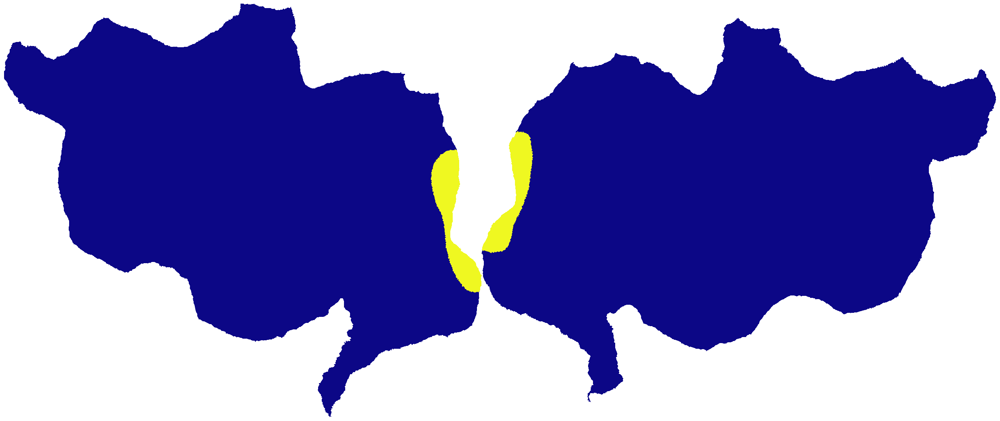

In [10]:
vertex_plot(subject=subject, data=myv1surf.mask, vmin=0, vmax=1)

### Step 3. Prepare some data

In [11]:
# Get volumes data
func_dir = "{}/{}/derivatives/pp_data/{}/func/fmriprep_{}".format(main_dir, project_dir, subject, high_pass_type)
func_dir = "/Users/martinszinte/Downloads"
gaze_ccw_vol_run1 = nb.load("{}/{}_ses-04_task-GazeCCW_run-1_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_ccw_vol_run2 = nb.load("{}/{}_ses-04_task-GazeCCW_run-2_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_cw_vol_run1 = nb.load("{}/{}_ses-04_task-GazeCW_run-1_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_cw_vol_run2 = nb.load("{}/{}_ses-04_task-GazeCW_run-2_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))

In [12]:
# Convert volumes to surfaces
mapper = cortex.get_mapper(subject, xfm_name, 'line_nearest', recache=True)
gaze_cw_surf_run1 = mapper(cortex.Volume(gaze_cw_vol_run1.get_fdata().T, subject, xfm_name)).data
gaze_cw_surf_run2 = mapper(cortex.Volume(gaze_cw_vol_run2.get_fdata().T, subject, xfm_name)).data
cw_center_idx = [0,69]
# CW run : 5 x 69 TR, 1:center, 2:right, 3:up, 4:left, 5:down
# CCW run : 5 x 69 TR, 1:down: 2:left, 3:up, 4:right, 5:center

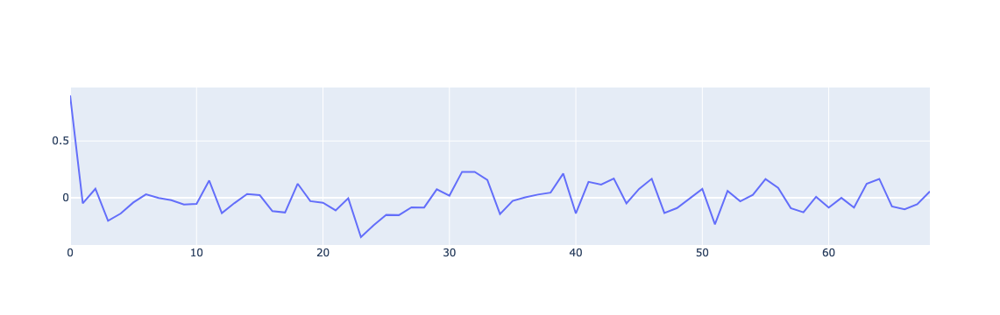

In [13]:
# plot average signal
import plotly.graph_objects as go
x = np.arange(0,gaze_cw_surf_run1.shape[0])
y = np.nanmean(gaze_cw_surf_run1[cw_center_idx[0]:cw_center_idx[1],:],axis=1)
fig = go.Figure([go.Scatter(x=x, y=y)])
fig.show()

In [14]:
# Define train and test data
mydat_train = gaze_cw_surf_run1[cw_center_idx[0]:cw_center_idx[1],:].T
mydat_test = gaze_cw_surf_run2[cw_center_idx[0]:cw_center_idx[1],:].T

### Stage 4. Make a connective field 'stimulus'

In [ ]:
train_stim = CFStimulus(data=mydat_train, 
                        vertinds=myv1surf.subsurface_verts, 
                        distances=myv1surf.distance_matrix)
# test_stim = CFStimulus(data=mydat_test,
#                        vertinds=myv1surf.subsurface_verts,
#                        distances=myv1surf.distance_matrix)

In [ ]:
train_stim.design_matrix

### Stage 5. Define model and CF size grid

In [ ]:
model = CFGaussianModel(train_stim)
sigmas = np.array([0.5,1,2,3,4,5,7,10,20,30,40])
sigmas = np.array([1,10,40])

### Stage 6. Define fitter and perform 'quick' grids

In [ ]:
gf = CFFitter(data=mydat_train2, model=model)
gf.quick_grid_fit(sigmas)

### Stage 7. Inspect outputs

In [21]:
gf.quick_gridsearch_params

array([[0.00000000e+00, 5.00000000e-01, 9.74855542e-01],
       [1.00000000e+00, 5.00000000e-01, 9.89507437e-01],
       [8.20000000e+01, 5.00000000e-01, 5.68723202e-01],
       ...,
       [1.79130000e+04, 5.00000000e-01, 2.21568808e-01],
       [1.79130000e+04, 5.00000000e-01, 2.01716602e-01],
       [1.51678000e+05, 5.00000000e-01, 1.86668634e-01]])

In [22]:
gf.quick_gridsearch_params.shape

(283210, 3)

In [23]:
# The first column is the vertex centre that best explained the timecourse.
gf.quick_gridsearch_params[:,0]

array([0.00000e+00, 1.00000e+00, 8.20000e+01, ..., 1.79130e+04,
       1.79130e+04, 1.51678e+05])

In [24]:
# which are available as ints in...
gf.quick_vertex_centres

# projected_somatotopy=my_somatotopic_map[gf.quick_vertex_centres]

array([     0,      1,     82, ...,  17913,  17913, 151678])

In [25]:
gf.quick_vertex_centres.shape

(283210,)

In [26]:
hem=(gf.quick_vertex_centres>myv1surf.leftlim).astype(int)

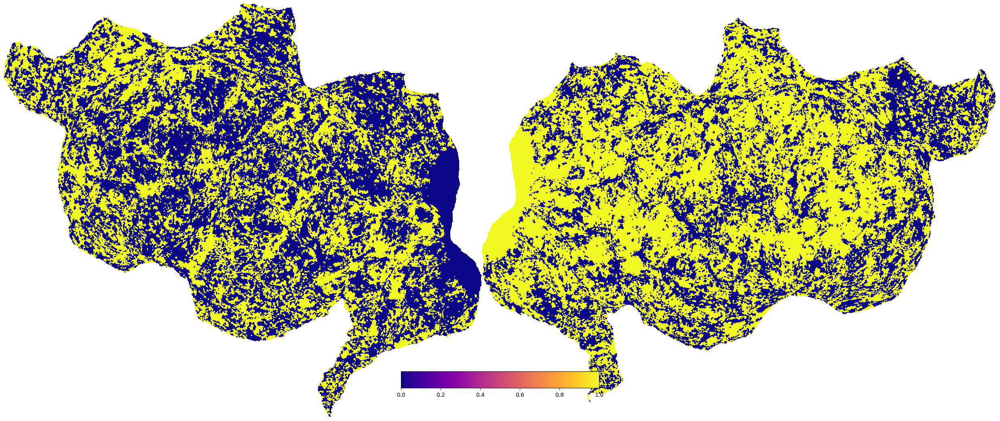

In [27]:
vertex_plot(subject=subject, data=hem, vmin=0, vmax=1, cmap='plasma', colorbar=True)

Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


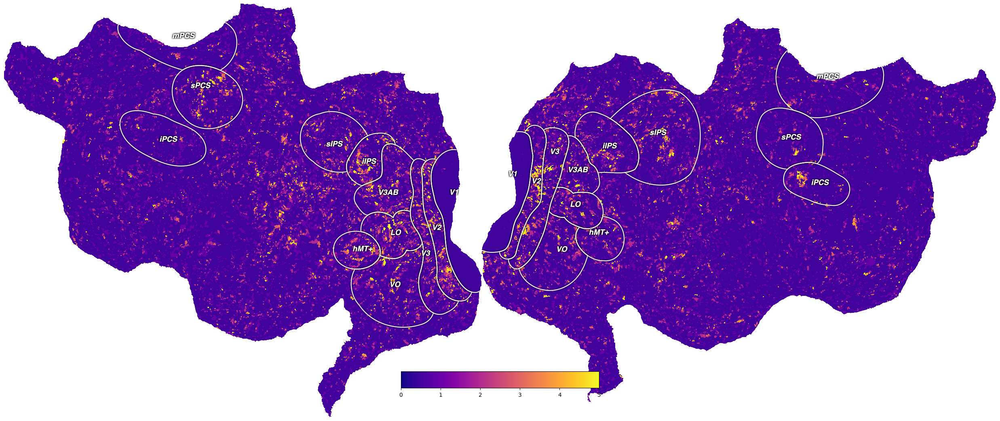

In [28]:
vertex_plot(subject=subject, data=gf.quick_gridsearch_params[:,1], vmin=0, vmax=5, rois=True, cmap='plasma', colorbar=True)

Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


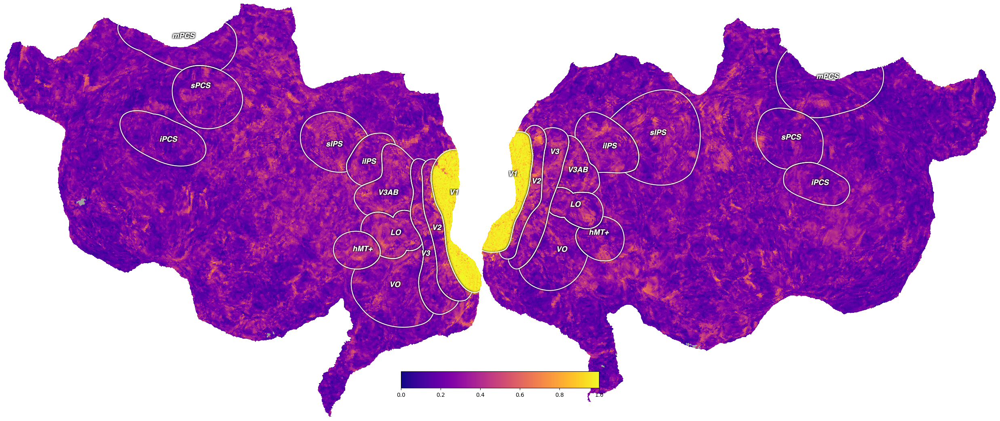

In [ ]:
vertex_plot(subject=subject, data=gf.quick_gridsearch_params[:,-1], vmin=0, vmax=1, rois=True, cmap='plasma', colorbar=True)

### Stage 8. Perform cross-validation.

In [ ]:
gf.quick_xval(test_data=mydat_test,test_stimulus=test_stim)

In [ ]:
gf.xval_R2

array([0.84100881, 0.97622412, 0.57666476, ..., 0.22301965, 0.23229815,
       0.12391091])

Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


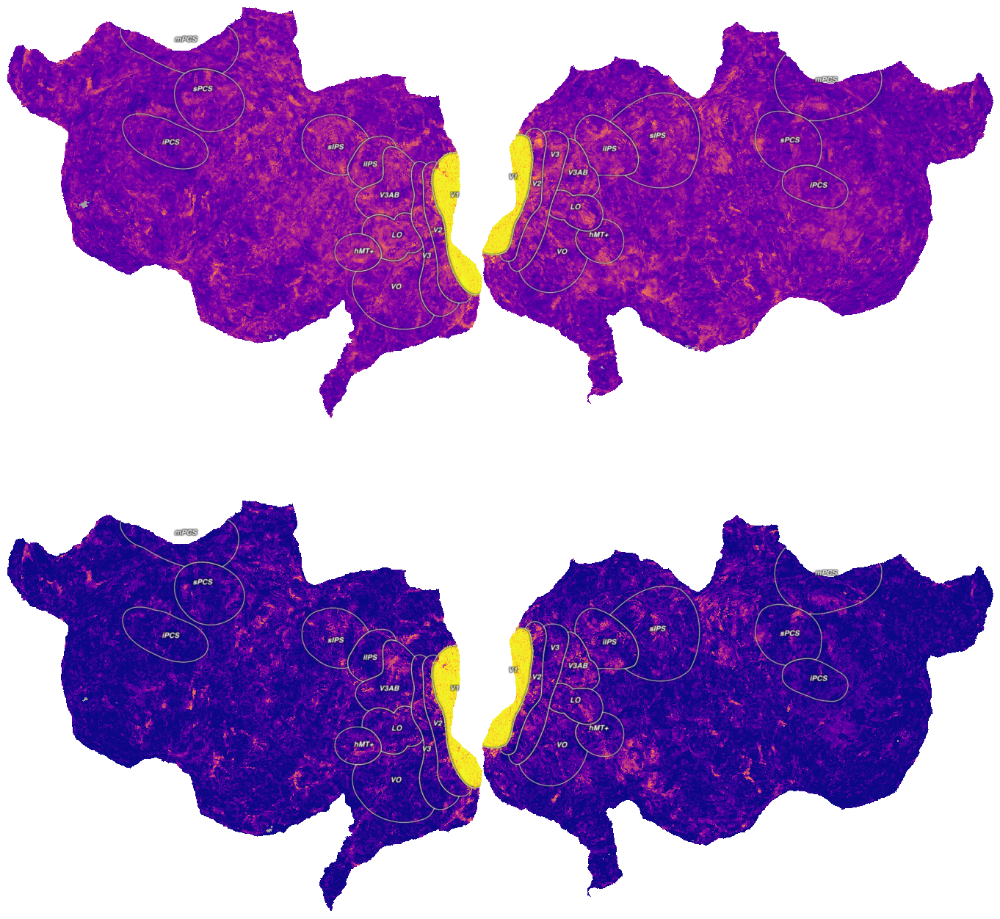

In [ ]:
import matplotlib.pyplot as plt
full_figsize = (24, 16)
fig, axs = plt.subplots(2, 1, figsize=full_figsize)

vertex_plot(subject=subject, data=gf.quick_gridsearch_params[:,-1], vmin=0, vmax=1, rois=True, cmap='plasma', ax=axs[0])
vertex_plot(subject=subject, data=gf.xval_R2, vmin=0, vmax=1, rois=True, cmap='plasma', ax=axs[1])

### Load pRF data and get connective field projections

In [47]:
sys.path.append("{}/../../utils".format(os.getcwd()))
from pycortex_utils import draw_cortex, set_pycortex_config_file

# Set folders
cortex_dir = "{}/{}/derivatives/pp_data/cortex".format(main_dir, project_dir)
fit_dir = "{}/{}/derivatives/pp_data/{}/prf/fit".format(main_dir, project_dir, subject)
deriv_avg_loo_fn = "{}/{}_task-prf_fmriprep_dct_bold_loo_avg_prf-deriv.nii.gz".format(fit_dir, subject)

# Define analysis parameters
with open('../../settings.json') as f:
    json_s = f.read()
    analysis_info = json.loads(json_s)


# Load params
deriv_fn = deriv_avg_loo_fn
deriv_img = nb.load(deriv_fn)
deriv_mat = deriv_img.get_fdata()

# Maps settings
params_num = 10
rsq_idx, rsq_loo_idx, ecc_idx, polar_real_idx, polar_imag_idx , size_idx, \
    amp_idx, baseline_idx, x_idx, y_idx = 0,1,2,3,4,5,6,7,8,9

cmap_polar, cmap_uni, cmap_ecc_size = 'hsv', 'Reds', 'Spectral'
col_offset = 1.0/14.0
cmap_steps = 255

# plot scales
rsq_scale = [0, 0.6]
ecc_scale = [0, 10]
size_scale = [0, 10]

# Threshold data
deriv_mat_th = deriv_mat
amp_down =  deriv_mat_th[...,amp_idx] > 0
rsqr_th_down = deriv_mat_th[...,rsq_idx] >= analysis_info['rsqr_th'][0]
rsqr_th_up = deriv_mat_th[...,rsq_idx] <= analysis_info['rsqr_th'][1]
size_th_down = deriv_mat_th[...,size_idx] >= analysis_info['size_th'][0]
size_th_up = deriv_mat_th[...,size_idx] <= analysis_info['size_th'][1]
ecc_th_down = deriv_mat_th[...,ecc_idx] >= analysis_info['ecc_th'][0]
ecc_th_up = deriv_mat_th[...,ecc_idx] <= analysis_info['ecc_th'][1]
all_th = np.array((amp_down,rsqr_th_down,rsqr_th_up,size_th_down,size_th_up,ecc_th_down,ecc_th_up)) 
deriv_mat[np.logical_and.reduce(all_th)==False,rsq_idx]=0

# Parameters in vertices
vert_rsq_data = mapper(cortex.Volume(deriv_mat[...,rsq_idx].T, subject, xfm_name)).data
vert_x_data = mapper(cortex.Volume(deriv_mat[...,x_idx].T, subject, xfm_name)).data
vert_y_data = mapper(cortex.Volume(deriv_mat[...,y_idx].T, subject, xfm_name)).data
vert_size_data = mapper(cortex.Volume(deriv_mat[...,size_idx].T, subject, xfm_name)).data
vert_ecc_data = mapper(cortex.Volume(deriv_mat[...,ecc_idx].T, subject, xfm_name)).data
vert_polar_real_data = mapper(cortex.Volume(deriv_mat[...,polar_real_idx].T, subject, xfm_name)).data
vert_polar_imag_data = mapper(cortex.Volume(deriv_mat[...,polar_imag_idx].T, subject, xfm_name)).data

# CF projected parameters
vert_cf_rsq_data = vert_rsq_data[gf.quick_vertex_centres]
vert_cf_x_data = vert_x_data[gf.quick_vertex_centres]
vert_cf_y_data = vert_y_data[gf.quick_vertex_centres]
vert_cf_size_data = vert_size_data[gf.quick_vertex_centres]
vert_cf_ecc_data = vert_ecc_data[gf.quick_vertex_centres]
vert_cf_polar_real_data = vert_polar_real_data[gf.quick_vertex_centres]
vert_cf_polar_imag_data = vert_polar_imag_data[gf.quick_vertex_centres]

In [48]:
maps_names = []

# Vertex analysis 
# ---------------

# R2
rsq_data = vert_rsq_data
alpha_range = analysis_info["alpha_range"]
alpha = (rsq_data - alpha_range[0])/(alpha_range[1]-alpha_range[0])
alpha[alpha>1]=1

# Polar angle
pol_comp_num = vert_polar_real_data + 1j * vert_polar_imag_data
polar_ang = np.angle(pol_comp_num)
ang_norm = (polar_ang + np.pi) / (np.pi * 2.0)
ang_norm = np.fmod(ang_norm + col_offset,1)
param_polar = {'data': ang_norm, 'cmap': cmap_polar, 'alpha': alpha, 
               'vmin': 0, 'vmax': 1, 'cmap_steps': cmap_steps, 'cortex_type': 'VertexRGB',
               'cbar': 'polar', 'col_offset': col_offset, 
               'description': 'PRF polar:{:3.0f} steps'.format(cmap_steps), 
               'curv_brightness': 0.1, 'curv_contrast': 0.25,
               'with_labels': True}
exec('param_polar_{cmap_steps}_vertex = param_polar'.format(cmap_steps = int(cmap_steps)))
exec('maps_names.append("polar_{cmap_steps}_vertex")'.format(cmap_steps = int(cmap_steps)))

# Eccentricity
ecc_data = vert_ecc_data
param_ecc_vertex = { 'data': ecc_data, 'cmap': cmap_ecc_size, 'alpha': alpha,
                     'vmin': ecc_scale[0], 'vmax': ecc_scale[1], 
                     'cbar': 'ecc', 'cortex_type': 'VertexRGB',
                     'description': 'PRF eccentricity'.format(), 'curv_brightness': 1,
                     'curv_contrast': 0.1, 'with_labels': True}
maps_names.append('ecc_vertex')

# Size
size_data = vert_size_data
param_size_vertex = {'data': size_data, 'cmap': cmap_ecc_size, 'alpha': alpha, 
              'vmin': size_scale[0], 'vmax': size_scale[1], 'cbar': 'discrete', 
              'cortex_type': 'VertexRGB', 'description': 'PRF size', 
              'curv_brightness': 1, 'curv_contrast': 0.1, 'cbar_label': 'pRF size',
              'with_labels': True}
maps_names.append('size_vertex')

polar_255_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
ecc_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
size_vertex


/Users/martinszinte/disks/meso_H/projects/gaze_exp/analysis_code/postproc/cf/../../utils/pycortex_utils.py:201: UserWarning:

FixedFormatter should only be used together with FixedLocator



Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


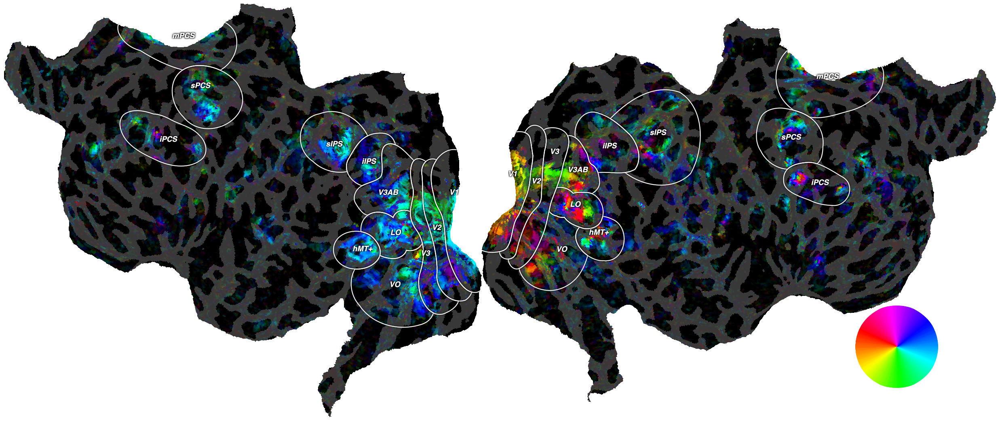

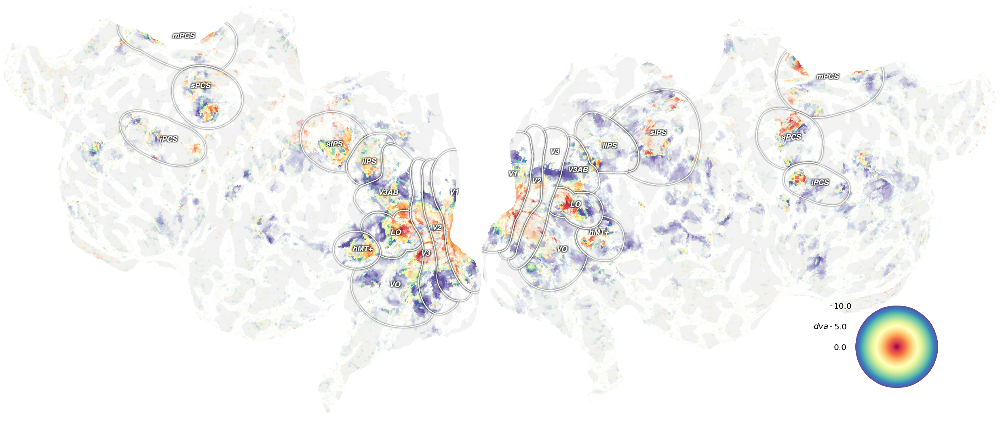

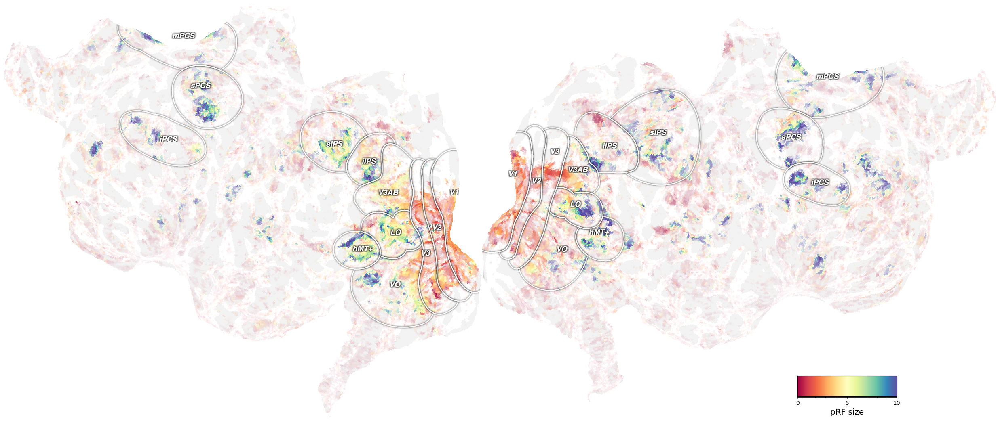

In [49]:
for maps_name in maps_names:
    # create flatmap
    roi_name = '{}'.format(maps_name)
    roi_param = {'subject': subject, 'xfmname': xfm_name, 'roi_name': roi_name}
    print(roi_name)
    exec('param_{}.update(roi_param)'.format(maps_name))
    exec('volume_{maps_name} = draw_cortex(**param_{maps_name})'.format(maps_name = maps_name))

In [62]:
maps_names = []

# R2
rsq_data = vert_rsq_data
alpha_range = analysis_info["alpha_range"]
alpha = (rsq_data - alpha_range[0])/(alpha_range[1]-alpha_range[0])
alpha[alpha>1] = 1

# CF Polar angle
pol_comp_num = vert_cf_polar_real_data + 1j * vert_cf_polar_imag_data
polar_ang = np.angle(pol_comp_num)
ang_norm = (polar_ang + np.pi) / (np.pi * 2.0)
ang_norm = np.fmod(ang_norm + col_offset,1)
param_polar = {'data': ang_norm, 'cmap': cmap_polar, 'alpha': alpha, 
               'vmin': 0, 'vmax': 1, 'cmap_steps': cmap_steps, 'cortex_type': 'VertexRGB',
               'cbar': 'polar', 'col_offset': col_offset, 
               'description': 'PRF polar:{:3.0f} steps'.format(cmap_steps), 
               'curv_brightness': 0.1, 'curv_contrast': 0.25,
               'with_labels': True}
exec('param_polar_{cmap_steps}_vertex = param_polar'.format(cmap_steps = int(cmap_steps)))
exec('maps_names.append("polar_{cmap_steps}_vertex")'.format(cmap_steps = int(cmap_steps)))

# Eccentricity
ecc_data = vert_cf_ecc_data
param_ecc_vertex = { 'data': ecc_data, 'cmap': cmap_ecc_size, 'alpha': alpha,
                     'vmin': ecc_scale[0], 'vmax': ecc_scale[1], 
                     'cbar': 'ecc', 'cortex_type': 'VertexRGB',
                     'description': 'PRF eccentricity'.format(), 'curv_brightness': 1,
                     'curv_contrast': 0.1, 'with_labels': True}
maps_names.append('ecc_vertex')

# Size
size_data = vert_cf_size_data
param_size_vertex = {'data': size_data, 'cmap': cmap_ecc_size, 'alpha': alpha, 
              'vmin': size_scale[0], 'vmax': size_scale[1], 'cbar': 'discrete', 
              'cortex_type': 'VertexRGB', 'description': 'PRF size', 
              'curv_brightness': 1, 'curv_contrast': 0.1, 'cbar_label': 'pRF size',
              'with_labels': True}
maps_names.append('size_vertex')

polar_255_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
ecc_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
size_vertex


/Users/martinszinte/disks/meso_H/projects/gaze_exp/analysis_code/postproc/cf/../../utils/pycortex_utils.py:201: UserWarning:

FixedFormatter should only be used together with FixedLocator



Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


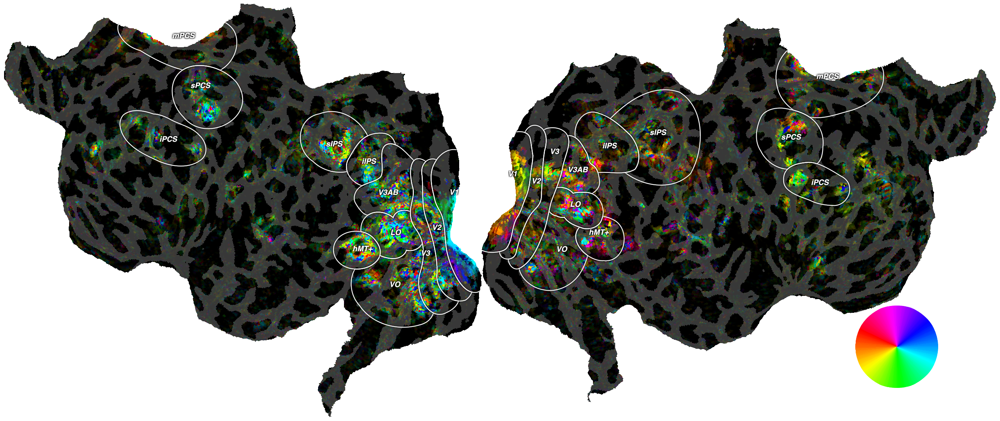

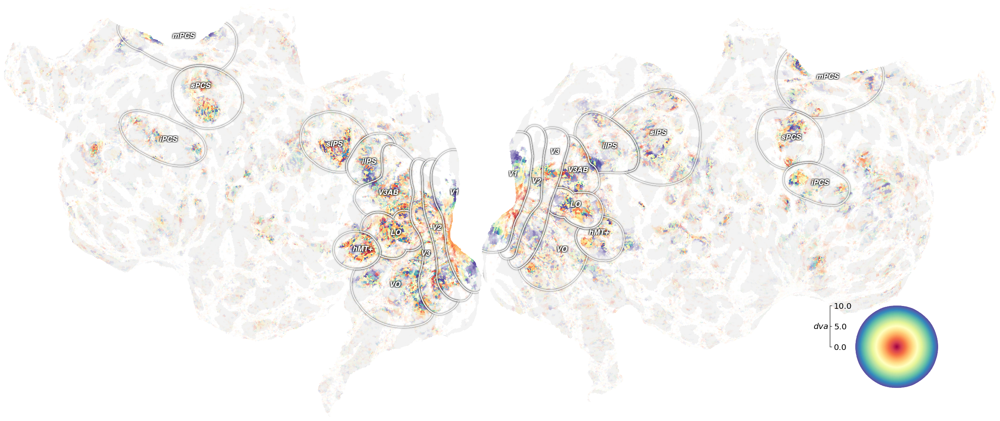

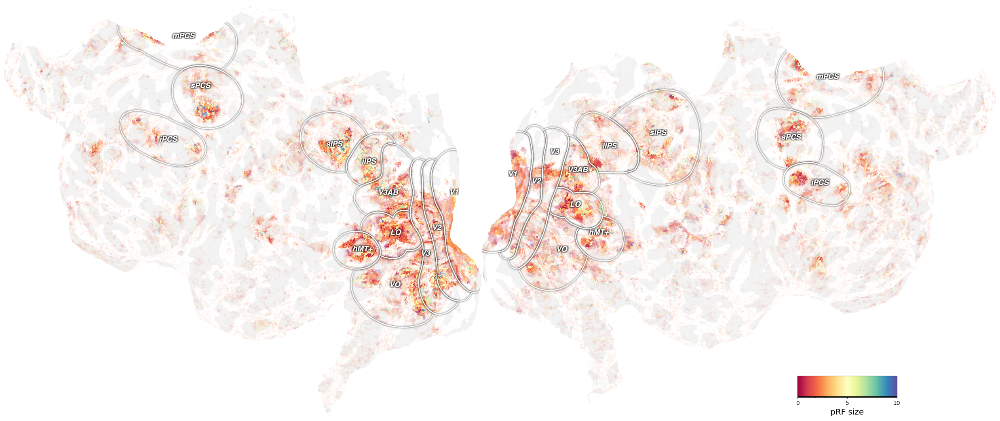

In [63]:
for maps_name in maps_names:
    # create flatmap
    roi_name = '{}'.format(maps_name)
    roi_param = {'subject': subject, 'xfmname': xfm_name, 'roi_name': roi_name}
    print(roi_name)
    exec('param_{}.update(roi_param)'.format(maps_name))
    exec('volume_{maps_name} = draw_cortex(**param_{maps_name})'.format(maps_name = maps_name))

### Average the runs which are identical

In [64]:
# Get volumes data
func_dir = "{}/{}/derivatives/pp_data/{}/func/fmriprep_{}".format(main_dir, project_dir, subject, high_pass_type)
func_dir = "/Users/martinszinte/Downloads"
gaze_ccw_vol_run1 = nb.load("{}/{}_ses-04_task-GazeCCW_run-1_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_ccw_vol_run2 = nb.load("{}/{}_ses-04_task-GazeCCW_run-2_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_cw_vol_run1 = nb.load("{}/{}_ses-04_task-GazeCW_run-1_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))
gaze_cw_vol_run2 = nb.load("{}/{}_ses-04_task-GazeCW_run-2_space-T1w_desc-preproc_bold_dct.nii.gz".format(func_dir, subject))

In [65]:
# Convert volumes to surfaces
mapper = cortex.get_mapper(subject, xfm_name, 'line_nearest', recache=True)
gaze_cw_surf_run1 = mapper(cortex.Volume(gaze_cw_vol_run1.get_fdata().T, subject, xfm_name)).data
gaze_cw_surf_run2 = mapper(cortex.Volume(gaze_cw_vol_run2.get_fdata().T, subject, xfm_name)).data
cw_center_idx = [0,69]
# CW run : 5 x 69 TR, 1:center, 2:right, 3:up, 4:left, 5:down
# CCW run : 5 x 69 TR, 1:down: 2:left, 3:up, 4:right, 5:center

In [74]:
gaze_cw_surf_runs = np.nanmean((gaze_cw_surf_run1,gaze_cw_surf_run2),axis=0)

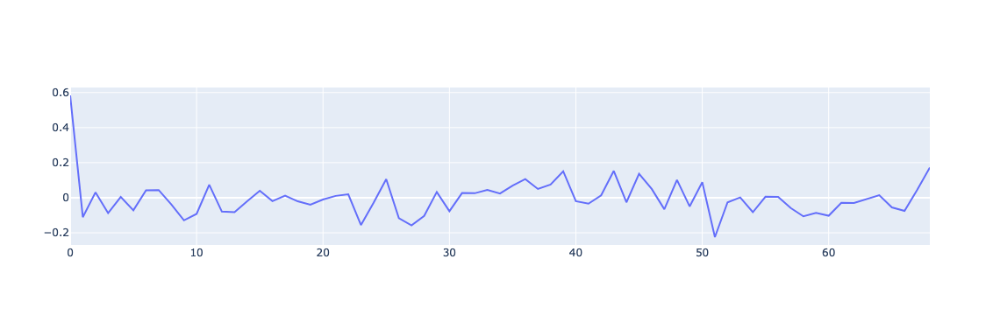

In [ ]:
# plot average signal over voxels
import plotly.graph_objects as go
x = np.arange(0,gaze_cw_surf_runs.shape[0])
y = np.nanmean(gaze_cw_surf_runs[cw_center_idx[0]:cw_center_idx[1],:],axis=1)
fig = go.Figure([go.Scatter(x=x, y=y)])
fig.show()

In [77]:
# Define train and test data
mydat_train = gaze_cw_surf_runs[cw_center_idx[0]:cw_center_idx[1],:].T
train_stim = CFStimulus(data=mydat_train, 
                        vertinds=myv1surf.subsurface_verts, 
                        distances=myv1surf.distance_matrix)

model = CFGaussianModel(train_stim)
sigmas = np.array([0.5,1,2,3,4,5,7,10,20,30,40])

In [78]:
gf = CFFitter(data=mydat_train, model=model)
gf.quick_grid_fit(sigmas)

In [79]:
# CF projected parameters
vert_cf_rsq_data = vert_rsq_data[gf.quick_vertex_centres]
vert_cf_x_data = vert_x_data[gf.quick_vertex_centres]
vert_cf_y_data = vert_y_data[gf.quick_vertex_centres]
vert_cf_size_data = vert_size_data[gf.quick_vertex_centres]
vert_cf_ecc_data = vert_ecc_data[gf.quick_vertex_centres]
vert_cf_polar_real_data = vert_polar_real_data[gf.quick_vertex_centres]
vert_cf_polar_imag_data = vert_polar_imag_data[gf.quick_vertex_centres]

polar_255_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
ecc_vertex
Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)
size_vertex


/Users/martinszinte/disks/meso_H/projects/gaze_exp/analysis_code/postproc/cf/../../utils/pycortex_utils.py:201: UserWarning:

FixedFormatter should only be used together with FixedLocator



Background RRGGBBAA: ffffff00
Area 0:0:2454.43:1024 exported to 2454 x 1024 pixels (96 dpi)


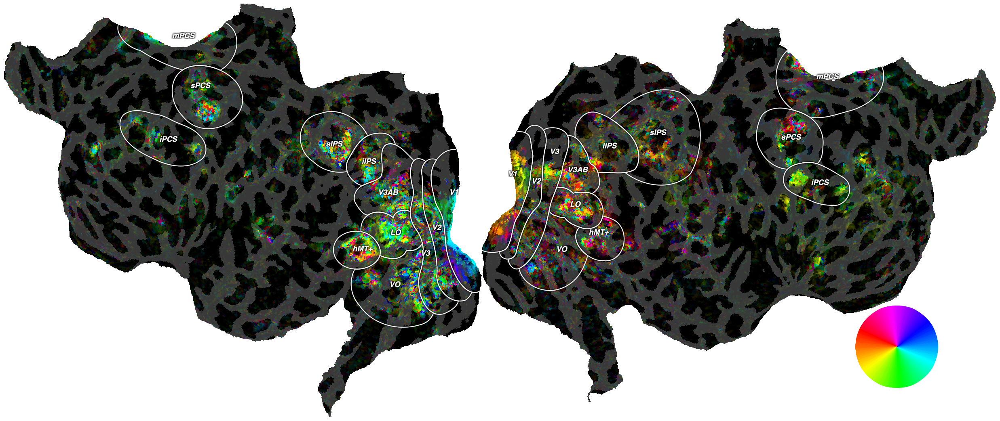

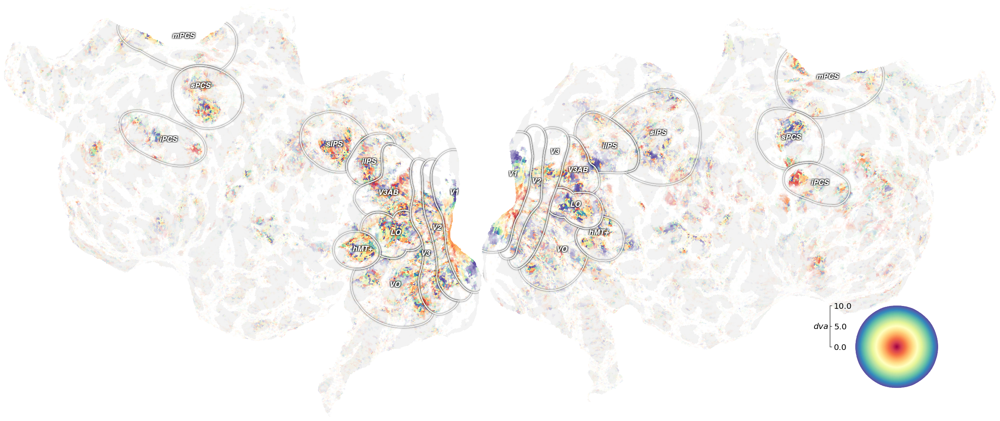

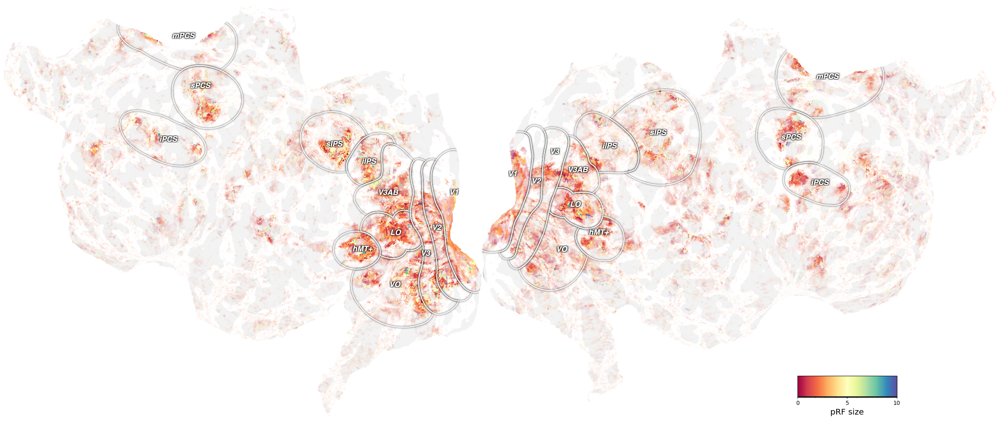

In [80]:
maps_names = []

# R2
rsq_data = vert_rsq_data
alpha_range = analysis_info["alpha_range"]
alpha = (rsq_data - alpha_range[0])/(alpha_range[1]-alpha_range[0])
alpha[alpha>1] = 1

# CF Polar angle
pol_comp_num = vert_cf_polar_real_data + 1j * vert_cf_polar_imag_data
polar_ang = np.angle(pol_comp_num)
ang_norm = (polar_ang + np.pi) / (np.pi * 2.0)
ang_norm = np.fmod(ang_norm + col_offset,1)
param_polar = {'data': ang_norm, 'cmap': cmap_polar, 'alpha': alpha, 
               'vmin': 0, 'vmax': 1, 'cmap_steps': cmap_steps, 'cortex_type': 'VertexRGB',
               'cbar': 'polar', 'col_offset': col_offset, 
               'description': 'PRF polar:{:3.0f} steps'.format(cmap_steps), 
               'curv_brightness': 0.1, 'curv_contrast': 0.25, 'with_labels': True}
exec('param_polar_{cmap_steps}_vertex = param_polar'.format(cmap_steps = int(cmap_steps)))
exec('maps_names.append("polar_{cmap_steps}_vertex")'.format(cmap_steps = int(cmap_steps)))

# CF Eccentricity
ecc_data = vert_cf_ecc_data
param_ecc_vertex = { 'data': ecc_data, 'cmap': cmap_ecc_size, 'alpha': alpha,
                     'vmin': ecc_scale[0], 'vmax': ecc_scale[1], 
                     'cbar': 'ecc', 'cortex_type': 'VertexRGB',
                     'description': 'PRF eccentricity'.format(), 'curv_brightness': 1,
                     'curv_contrast': 0.1, 'with_labels': True}
maps_names.append('ecc_vertex')

# CF Size
size_data = vert_cf_size_data
param_size_vertex = {'data': size_data, 'cmap': cmap_ecc_size, 'alpha': alpha, 
              'vmin': size_scale[0], 'vmax': size_scale[1], 'cbar': 'discrete', 
              'cortex_type': 'VertexRGB', 'description': 'PRF size', 'curv_brightness': 1,
              'curv_contrast': 0.1, 'cbar_label': 'pRF size', 'with_labels': True}
maps_names.append('size_vertex')

for maps_name in maps_names:
    # create flatmap
    roi_name = '{}'.format(maps_name)
    roi_param = {'subject': subject, 'xfmname': xfm_name, 'roi_name': roi_name}
    print(roi_name)
    exec('param_{}.update(roi_param)'.format(maps_name))
    exec('volume_{maps_name} = draw_cortex(**param_{maps_name})'.format(maps_name = maps_name))

## TODO
- [x] Plug function for drawing parameters
- [x] Plot parameters for eccentricity / size
- [x] Plot CF parameter for polar / eccentricity / size
- [x] Average the two runs and don't do the validation
- [x] Check out outputs
- [ ] Code saving the output in nifti back
- [ ] Code the 4 fixating directions too